In [1]:
%pylab inline
%matplotlib inline
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, Image

Populating the interactive namespace from numpy and matplotlib


In [2]:
def get_next_step(r, x):
    return r * x * (1. - x)

In [3]:
step_count = np.power(10, 5)

x_initial_state = 0.1

r_slices = np.power(10, 3)

r_range = linspace(1, 10, r_slices)

iter_data = empty((r_slices, r_slices))

In [4]:
for i, r in enumerate(r_range):

    x = [x_initial_state]

    [x.append(get_next_step(r, x[-1])) for _ in np.arange(step_count)]

    iter_data[i] = x[i + 10000 : i + 10000 + len(r_range)]

if len(x) == step_count + 1:
    print("iteration data succesfully added!")

/snap/jupyter/6/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: overflow encountered in double_scalars
  


iteration data succesfully added!


In [5]:
size(iter_data)

1000000

/snap/jupyter/6/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in log
  


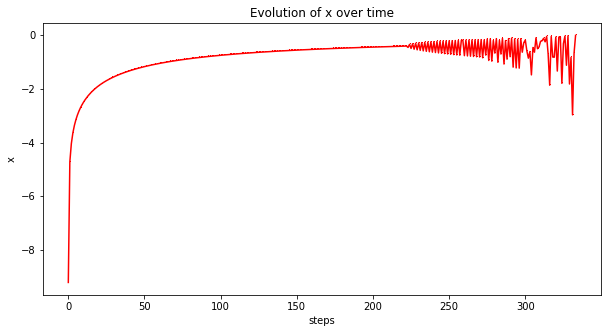

In [6]:
fig, ax = subplots(figsize=(10, 5))

xlabel('steps')
ylabel('x')
    
ax.plot(np.arange(0, r_slices, 1), np.log(iter_data[:, 1]), '-,', color='red')

ax.set_title("Evolution of x over time")    
# axis('off')
pyplot.show()

In [7]:
rcParams['animation.embed_limit'] = 200

In [8]:
min_r = min(r_range)
max_x = amax(iter_data)

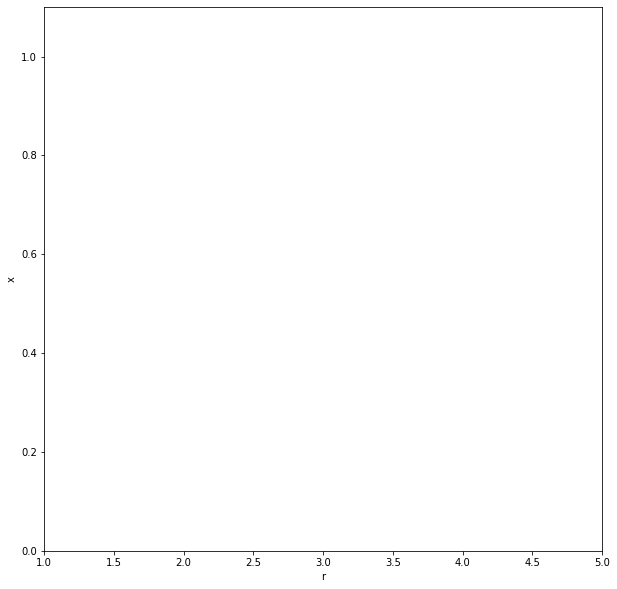

In [11]:
fig, ax = subplots(figsize=(10, 10))

ax.axis([min_r, 5, 0, max_x + 0.1])

xlabel('r')
ylabel('x')

figure, = ax.plot([], [], '.', color='red')

t = [r * ones(iter_data.shape[0]) for r in r_range]
x = iter_data

def animate(i):
    figure.set_data(t[:i], x[:i])

ani = FuncAnimation(fig, animate, frames=len(t), interval=25)

HTML(ani.to_jshtml())

In [13]:
ani.save('bifurcation.gif', fps=15)

MovieWriter ffmpeg unavailable; using Pillow instead.
